# Simple exploration

objectif : avoir une vue d'ensemble sur les donnees produites avec le pipeline airflow.
   - statistiques globales
   - identification des crises et intercrises

## Librairies

In [1]:
import os
import glob

import pandas as pd
import numpy as np

import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.io as pio
from matplotlib import pyplot as plt
import seaborn as sns

## Load dataset

In [2]:
# Path to dir to save figures
figures_path = 'figures/'
# List of files
files_path = "../seizure_detection_pipeline/output/cons-v0_6/*/cons_PAT_*.csv"
# # Path to output files
res_path = "res/general/"

In [3]:
# Creation of a list of file path
patient_files = glob.glob(files_path, recursive = True)
df_files = pd.DataFrame(patient_files, columns = ['path'])


def extract_patient_id(path):
    return int(path.split('cons_PAT_')[1].split('_Annotations')[0])

def extract_session_id(path):
    return int(path.split('_s')[0].split('_')[-1])

def extract_segment_id(path):
    return int(path.split('_s')[1].split('.csv')[0])


df_files['patient_id'] = df_files['path'].apply(extract_patient_id)
df_files['session_id'] = df_files['path'].apply(extract_session_id)
df_files['segment_id'] = df_files['path'].apply(extract_segment_id)

### Session exploration

##### Patient 18

In [4]:
df_session = pd.read_csv(df_files.loc[15]["path"])
df_session.head(15)

,interval_index,interval_start_time,mean_nni,sdnn,sdsd,nni_50,pnni_50,nni_20,pnni_20,rmssd,...,csi,cvi,Modified_csi,sampen,sd1,sd2,ratio_sd2_sd1,timestamp,filename,label
0,1.0,1000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2017-02-13 15:28:19.750,/home/aura-sakhite/seizure_detection_pipeline/...,0
1,2.0,2000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2017-02-13 15:28:20.750,/home/aura-sakhite/seizure_detection_pipeline/...,0
2,3.0,3000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2017-02-13 15:28:21.750,/home/aura-sakhite/seizure_detection_pipeline/...,0
3,4.0,4000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2017-02-13 15:28:22.750,/home/aura-sakhite/seizure_detection_pipeline/...,0
4,5.0,5000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2017-02-13 15:28:23.750,/home/aura-sakhite/seizure_detection_pipeline/...,0
5,6.0,6000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2017-02-13 15:28:24.750,/home/aura-sakhite/seizure_detection_pipeline/...,0
6,7.0,7000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2017-02-13 15:28:25.750,/home/aura-sakhite/seizure_detection_pipeline/...,0
7,8.0,8000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2017-02-13 15:28:26.750,/home/aura-sakhite/seizure_detection_pipeline/...,0
8,9.0,9000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2017-02-13 15:28:27.750,/home/aura-sakhite/seizure_detection_pipeline/...,0
9,10.0,10000.0,743.389423,22.176621,22.288077,0.0,0.0,5.0,41.666667,22.439698,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2017-02-13 15:28:28.750,/home/aura-sakhite/seizure_detection_pipeline/...,0


In [5]:
df_session.describe()

,interval_index,interval_start_time,mean_nni,sdnn,sdsd,nni_50,pnni_50,nni_20,pnni_20,rmssd,...,vlf,lf_hf_ratio,csi,cvi,Modified_csi,sampen,sd1,sd2,ratio_sd2_sd1,label
count,61665.000000,6.166500e+04,55074.000000,55074.000000,55074.000000,57144.000000,57144.000000,57144.000000,57144.000000,55074.000000,...,54974.000000,54974.000000,55034.000000,55034.000000,55034.000000,5.739100e+04,55034.000000,55034.000000,55034.000000,61665.000000
mean,30833.000000,3.083300e+07,775.063762,81.833356,62.958888,3.348261,25.478805,6.711518,53.878574,64.665363,...,5492.697060,2.432511,2.653417,4.674710,1507.990297,inf,49.392282,132.220626,2.653417,0.003308
std,17801.296512,1.780130e+07,122.132313,94.657241,68.630763,4.212817,29.605482,3.802956,25.377585,70.596625,...,9897.513483,1.958152,0.851877,0.743071,1551.160433,NaN,45.760450,125.497905,0.851877,0.057422
min,1.000000,1.000000e+03,375.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,7.673692,0.129215,0.798665,3.304956,90.439021,-0.000000e+00,6.329614,16.401099,0.798665,0.000000
25%,15417.000000,1.541700e+07,697.395833,23.084277,22.043905,0.000000,0.000000,4.000000,35.714286,22.439698,...,209.690199,1.176355,2.069778,4.054335,340.953133,9.926637e-01,18.289161,39.015804,2.069778,0.000000
50%,30833.000000,3.083300e+07,760.817308,33.656018,30.667034,1.000000,10.000000,6.000000,54.545455,31.168514,...,766.911630,1.942474,2.560800,4.371641,789.825534,1.369487e+00,24.480221,66.731304,2.560800,0.000000
75%,46249.000000,4.624900e+07,864.346591,110.939177,79.355390,6.000000,47.368421,9.000000,72.727273,81.928110,...,5925.005900,3.081617,3.086299,5.352361,2409.326480,1.765784e+00,72.479432,202.561842,3.086299,0.000000
max,61665.000000,6.166500e+07,1790.039062,628.136660,560.444744,20.000000,100.000000,24.000000,100.000000,564.106660,...,75781.472229,22.990640,10.672185,6.347841,11780.162718,inf,247.964416,613.667515,10.672185,1.000000


In [6]:
df_session.label.unique()

array([0, 1])

In [7]:
df_session.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 61665 entries, 0 to 61664
Data columns (total 32 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   interval_index       61665 non-null  float64
 1   interval_start_time  61665 non-null  float64
 2   mean_nni             55074 non-null  float64
 3   sdnn                 55074 non-null  float64
 4   sdsd                 55074 non-null  float64
 5   nni_50               57144 non-null  float64
 6   pnni_50              57144 non-null  float64
 7   nni_20               57144 non-null  float64
 8   pnni_20              57144 non-null  float64
 9   rmssd                55074 non-null  float64
 10  median_nni           55074 non-null  float64
 11  range_nni            55074 non-null  float64
 12  cvsd                 55074 non-null  float64
 13  cvnni                55074 non-null  float64
 14  mean_hr              55074 non-null  float64
 15  max_hr               55074 non-null 

In [6]:
df_session = df_session.sort_values(by = 'timestamp').reset_index(drop=True)

##### Corrélation dans le temps

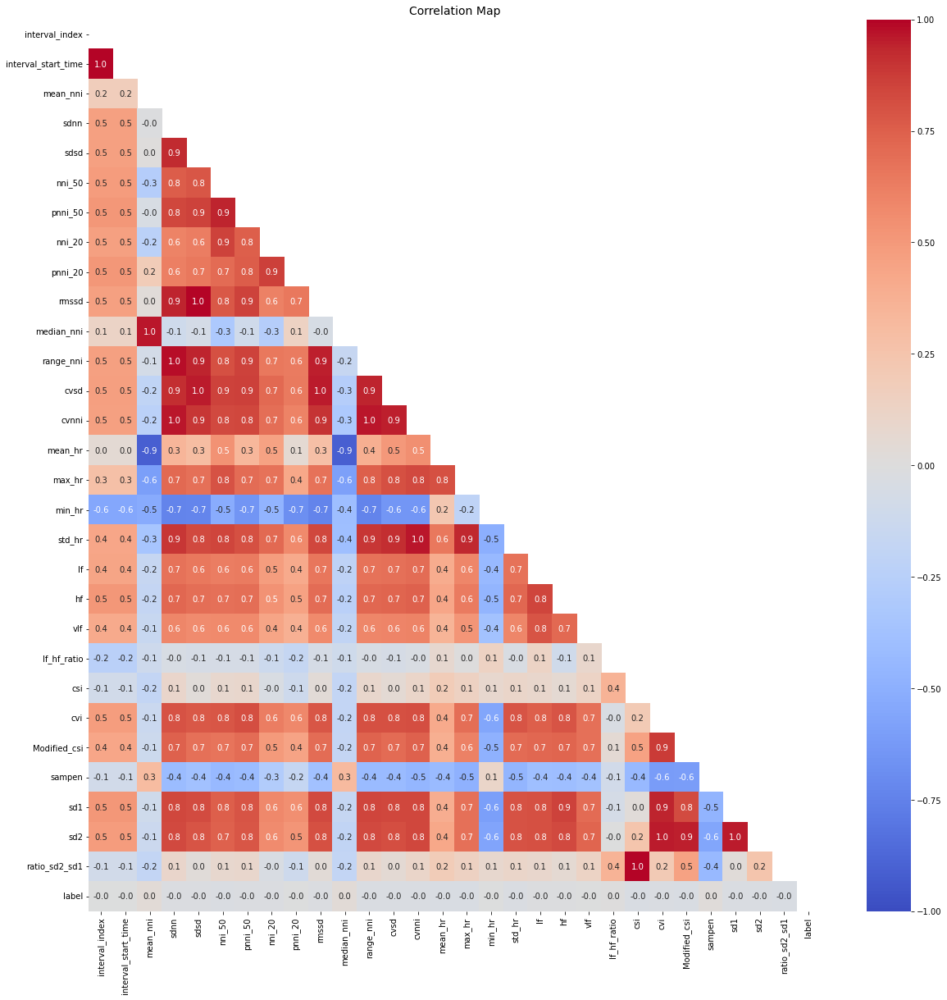

In [13]:
f, ax = plt.subplots(figsize = (20,20))
corr = df_session.corr()
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask)] = True
sns.heatmap(df_session.corr(), mask=mask, annot=True, fmt='.1f',
            ax=ax, cmap='coolwarm', vmin=-1, vmax=1)
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.title('Correlation Map', size=14);

In [10]:
df_session.corr()

,interval_index,interval_start_time,mean_nni,sdnn,sdsd,nni_50,pnni_50,nni_20,pnni_20,rmssd,...,vlf,lf_hf_ratio,csi,cvi,Modified_csi,sampen,sd1,sd2,ratio_sd2_sd1,label
interval_index,1.000000,1.000000,0.177004,0.461243,0.467576,0.488822,0.509211,0.463277,0.514270,0.468234,...,0.410308,-0.235804,-0.089283,0.477597,0.430959,-0.093255,0.512121,0.489041,-0.089283,-0.006831
interval_start_time,1.000000,1.000000,0.177004,0.461243,0.467576,0.488822,0.509211,0.463277,0.514270,0.468234,...,0.410308,-0.235804,-0.089283,0.477597,0.430959,-0.093255,0.512121,0.489041,-0.089283,-0.006831
mean_nni,0.177004,0.177004,1.000000,-0.014382,0.013026,-0.271970,-0.044326,-0.234251,0.188252,0.030151,...,-0.148565,-0.116272,-0.186985,-0.133166,-0.121080,0.307813,-0.103546,-0.129059,-0.186985,0.035178
sdnn,0.461243,0.461243,-0.014382,1.000000,0.928752,0.765615,0.838231,0.607178,0.621616,0.944622,...,0.588084,-0.040183,0.099849,0.803080,0.744953,-0.416773,0.840994,0.835222,0.099849,-0.023114
sdsd,0.467576,0.467576,0.013026,0.928752,1.000000,0.781756,0.854551,0.628487,0.654192,0.994235,...,0.567448,-0.061269,0.029706,0.775910,0.686079,-0.375873,0.827658,0.795882,0.029706,-0.022436
nni_50,0.488822,0.488822,-0.271970,0.765615,0.781756,1.000000,0.937647,0.859093,0.703426,0.774354,...,0.570893,-0.058164,0.085721,0.782318,0.664551,-0.435772,0.752561,0.746093,0.085721,-0.026282
pnni_50,0.509211,0.509211,-0.044326,0.838231,0.854551,0.937647,1.000000,0.751430,0.760986,0.858937,...,0.574199,-0.058390,0.086053,0.813247,0.701380,-0.419185,0.796358,0.786124,0.086053,-0.021900
nni_20,0.463277,0.463277,-0.234251,0.607178,0.628487,0.859093,0.751430,1.000000,0.860916,0.616630,...,0.444877,-0.123296,-0.037221,0.626985,0.495444,-0.286979,0.585023,0.568530,-0.037221,-0.019114
pnni_20,0.514270,0.514270,0.188252,0.621616,0.654192,0.703426,0.760986,0.860916,1.000000,0.656237,...,0.378762,-0.168005,-0.115882,0.578987,0.448370,-0.164281,0.554653,0.522713,-0.115882,-0.004933
rmssd,0.468234,0.468234,0.030151,0.944622,0.994235,0.774354,0.858937,0.616630,0.656237,1.000000,...,0.572518,-0.059505,0.034819,0.782525,0.696895,-0.378465,0.835806,0.805724,0.034819,-0.022635


In [11]:
np.abs(df_session.corr()['label']) >= .6

interval_index         False
interval_start_time    False
mean_nni               False
sdnn                   False
sdsd                   False
nni_50                 False
pnni_50                False
nni_20                 False
pnni_20                False
rmssd                  False
median_nni             False
range_nni              False
cvsd                   False
cvnni                  False
mean_hr                False
max_hr                 False
min_hr                 False
std_hr                 False
lf                     False
hf                     False
vlf                    False
lf_hf_ratio            False
csi                    False
cvi                    False
Modified_csi           False
sampen                 False
sd1                    False
sd2                    False
ratio_sd2_sd1          False
label                   True
Name: label, dtype: bool

In [12]:
sort_corr = np.abs(df_session.corr()).sort_values(by='label', ascending=False)
sort_corr

,interval_index,interval_start_time,mean_nni,sdnn,sdsd,nni_50,pnni_50,nni_20,pnni_20,rmssd,...,vlf,lf_hf_ratio,csi,cvi,Modified_csi,sampen,sd1,sd2,ratio_sd2_sd1,label
label,0.006831,0.006831,0.035178,0.023114,0.022436,0.026282,0.021900,0.019114,0.004933,0.022635,...,0.003356,0.000624,0.031695,0.026346,0.031940,0.016520,0.023446,0.029275,0.031695,1.000000
mean_hr,0.049171,0.049171,0.912648,0.345008,0.297630,0.534832,0.336911,0.455581,0.058997,0.287733,...,0.354140,0.071008,0.193496,0.410881,0.390089,0.424101,0.395760,0.422784,0.193496,0.036151
max_hr,0.275721,0.275721,0.595294,0.717648,0.684106,0.798200,0.700024,0.672582,0.422975,0.679550,...,0.521603,0.004584,0.141779,0.691938,0.611891,0.489828,0.684447,0.687471,0.141779,0.035965
mean_nni,0.177004,0.177004,1.000000,0.014382,0.013026,0.271970,0.044326,0.234251,0.188252,0.030151,...,0.148565,0.116272,0.186985,0.133166,0.121080,0.307813,0.103546,0.129059,0.186985,0.035178
median_nni,0.118127,0.118127,0.963141,0.105674,0.064126,0.315685,0.095928,0.272848,0.137203,0.049260,...,0.193368,0.105463,0.184329,0.185641,0.179595,0.318808,0.166465,0.192572,0.184329,0.033792
Modified_csi,0.430959,0.430959,0.121080,0.744953,0.686079,0.664551,0.701380,0.495444,0.448370,0.696895,...,0.681829,0.051022,0.460811,0.882415,1.000000,0.602055,0.823379,0.949372,0.460811,0.031940
ratio_sd2_sd1,0.089283,0.089283,0.186985,0.099849,0.029706,0.085721,0.086053,0.037221,0.115882,0.034819,...,0.130535,0.364423,1.000000,0.210454,0.460811,0.436631,0.029817,0.244709,1.000000,0.031695
csi,0.089283,0.089283,0.186985,0.099849,0.029706,0.085721,0.086053,0.037221,0.115882,0.034819,...,0.130535,0.364423,1.000000,0.210454,0.460811,0.436631,0.029817,0.244709,1.000000,0.031695
sd2,0.489041,0.489041,0.129059,0.835222,0.795882,0.746093,0.786124,0.568530,0.522713,0.805724,...,0.730351,0.004722,0.244709,0.954643,0.949372,0.562164,0.957182,1.000000,0.244709,0.029275
std_hr,0.430513,0.430513,0.349693,0.891468,0.834030,0.846229,0.812193,0.715573,0.576197,0.836921,...,0.589896,0.037061,0.106121,0.792472,0.710781,0.464515,0.802811,0.799444,0.106121,0.028700


In [ ]:
df_session

##### Trois variables les plus corrélées au label

In [13]:
sort_corr['label'].head(4)

label       1.000000
mean_hr     0.036151
max_hr      0.035965
mean_nni    0.035178
Name: label, dtype: float64

##### Trois variables les moins corrélées au label

In [14]:
sort_corr['label'].loc['min_hr':]

min_hr         0.004124
vlf            0.003356
lf_hf_ratio    0.000624
Name: label, dtype: float64

In [15]:
#session start
df_session['timestamp'].iloc[0]

'2017-02-13 15:28:19.750'

In [16]:
#session end
df_session['timestamp'].iloc[-1]

'2017-02-14 08:36:03.750'

In [17]:
#session duration : since time between row is 1sec
df_session.shape[0]

61665

In [18]:
#session in hour
df_session.shape[0]/3600

17.129166666666666

In [19]:
#total_seizure_duration_sec
df_session[df_session['label']==1].label.sum()

204

In [20]:
#total_interseizure_duration_sec
(df_session['label'] == 0).sum()    

61461

In [21]:
## Analysis of seizures inside session ##
# Detect change of state
df_session['previous_label'] = df_session['label'].shift(1)
df_session['change_of_state'] = (df_session['label'] != df_session['previous_label'])
df_session['change_of_state'].value_counts()
df_session['future_change_of_state'] = df_session['change_of_state'].shift(-1).fillna(True)

<AxesSubplot:xlabel='label', ylabel='mean_nni'>

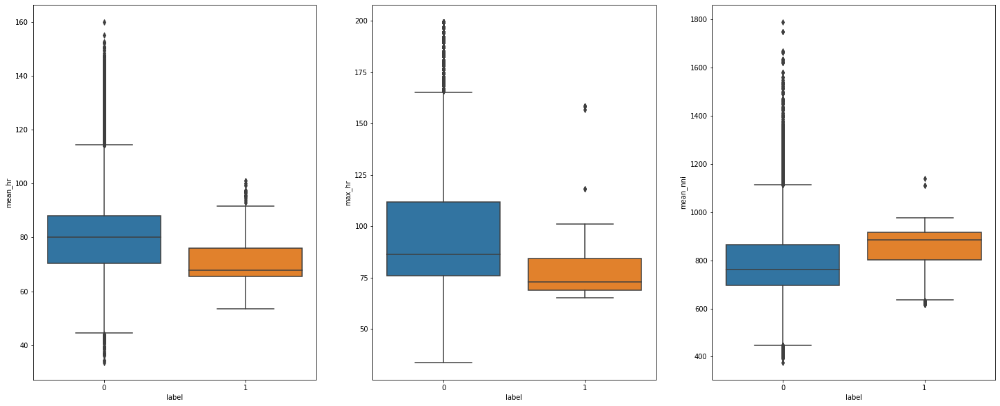

In [22]:
plt.figure(figsize=(25,10))
plt.subplot(1,3,1)
sns.boxplot(x='label',y='mean_hr', data=df_session)
plt.subplot(1,3,2)
sns.boxplot(x='label',y='max_hr', data=df_session)
plt.subplot(1,3,3)
sns.boxplot(x='label',y='mean_nni', da[ta=df_session)

In [27]:
df_session_1 = df_session.dropna()[df_session.dropna()['label']==1]
df_session_0 = df_session.dropna()[df_session.dropna()['label']==0]

In [28]:
df_session_1.label.unique()

array([1])

In [29]:
df_session_0.label.unique()

array([0])

In [30]:
from scipy.stats import ttest_ind
t_stat, p = ttest_ind(df_session_1['mean_hr'], df_session_0['mean_hr'])
print(f't={t_stat}, p={p}')

t=-8.027988484497813, p=1.0116557849811907e-15


In [32]:
t_stat, p = ttest_ind(df_session_1['max_hr'], df_session_0['max_hr'])
print(f't={t_stat}, p={p}')

t=-7.735944473425419, p=1.0449937433408882e-14


In [33]:
t_stat, p = ttest_ind(df_session_1['lf_hf_ratio'], df_session_0['lf_hf_ratio'])
print(f't={t_stat}, p={p}')

t=0.216153438993802, p=0.8288690029957008


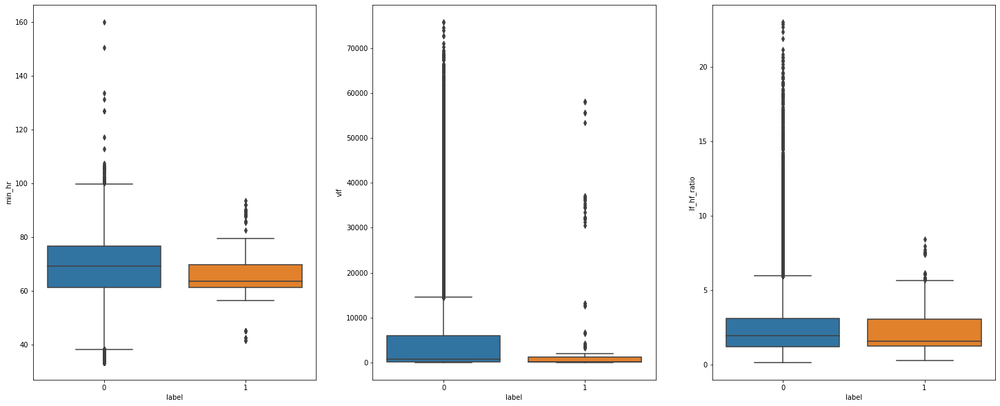

In [23]:
plt.figure(figsize=(25,10))
plt.subplot(1,3,1)
sns.boxplot(x='label',y='min_hr', data=df_session);
plt.subplot(1,3,2)
sns.boxplot(x='label',y='vlf', data=df_session);
plt.subplot(1,3,3)
sns.boxplot(x='label',y='lf_hf_ratio', data=df_session);

#### Distribution des variables les plus corrélées aux données

<AxesSubplot:xlabel='mean_nni', ylabel='Density'>

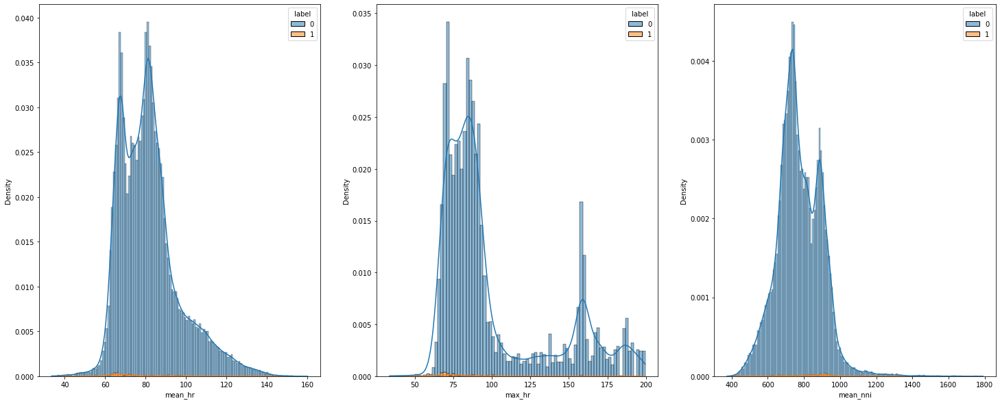

In [24]:
plt.figure(figsize=(25,10))
plt.subplot(1,3,1)
sns.histplot(data=df_session, x='mean_hr', kde=True, hue="label", multiple="stack", stat='density')
plt.subplot(1,3,2)
sns.histplot(data=df_session, x='max_hr', kde=True, hue="label", multiple="stack", stat='density')
plt.subplot(1,3,3)
sns.histplot(data=df_session, x='mean_nni', kde=True, hue="label", multiple="stack", stat='density')

#### Distribution des variables les moins corrélées

<AxesSubplot:xlabel='lf_hf_ratio', ylabel='Density'>

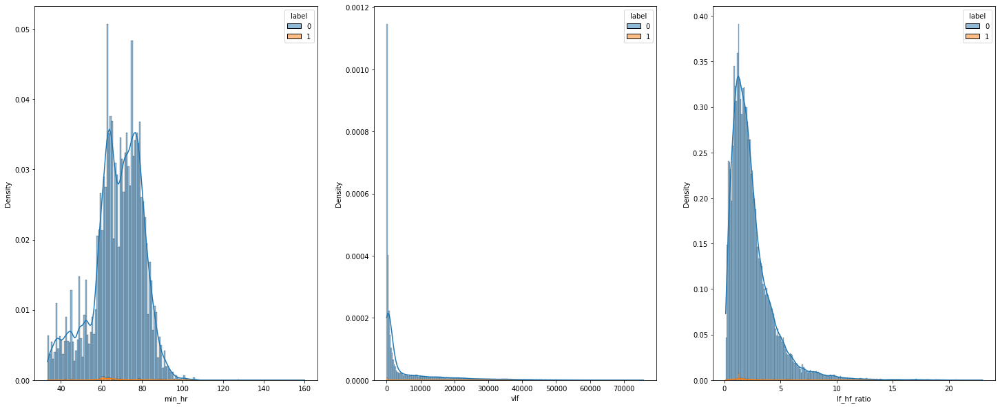

In [25]:
plt.figure(figsize=(25,10))
plt.subplot(1,3,1)
sns.histplot(data=df_session, x='min_hr', kde=True, hue="label", multiple="stack", stat='density')
plt.subplot(1,3,2)
sns.histplot(data=df_session, x='vlf', kde=True, hue="label", multiple="stack", stat='density')
plt.subplot(1,3,3)
sns.histplot(data=df_session, x='lf_hf_ratio', kde=True, hue="label", multiple="stack", stat='density')

In [26]:
df_session_copy = df_session.set_index("timestamp")

### Seizure informations from session

In [27]:
df_seizure = pd.DataFrame()
df_seizure['start_date'] = df_session.loc[(df_session['label']==1) 
                                               & (df_session['change_of_state']), 'timestamp'].reset_index(
        drop=True)
df_seizure['end_date'] = df_session.loc[(df_session['label']==1) 
                                             &(df_session['future_change_of_state']),'timestamp'].reset_index(
        drop=True)

df_seizure['duration_sec'] = (pd.to_datetime(df_seizure['end_date']) 
                                 - pd.to_datetime(df_seizure['start_date'])).apply(
        lambda x : x.total_seconds() + 1)
    

In [28]:
# Create df_interseizures with detail of start and end of each interseizure
df_interseizure = pd.DataFrame()
df_interseizure['start_date'] = df_session.loc[(df_session['label']==0) 
                                           & (df_session['change_of_state']), 'timestamp'].reset_index(
    drop=True)
df_interseizure['end_date'] = df_session.loc[(df_session['label']==0) 
                                         &(df_session['future_change_of_state']),'timestamp'].reset_index(
    drop=True)

df_interseizure['duration_sec'] = (pd.to_datetime(df_interseizure['end_date']) 
                             - pd.to_datetime(df_interseizure['start_date'])).apply(lambda x: 
                                                                                     x.total_seconds()+1)

In [29]:
df_seizure.head()

,start_date,end_date,duration_sec
0,2017-02-13 16:10:05.750,2017-02-13 16:10:09.750,5.0
1,2017-02-13 16:15:41.750,2017-02-13 16:15:45.750,5.0
2,2017-02-13 16:19:10.750,2017-02-13 16:19:14.750,5.0
3,2017-02-13 16:25:50.750,2017-02-13 16:25:53.750,4.0
4,2017-02-13 16:26:37.750,2017-02-13 16:26:39.750,3.0


In [30]:
df_interseizure.head()

,start_date,end_date,duration_sec
0,2017-02-13 15:28:19.750,2017-02-13 16:10:04.750,2506.0
1,2017-02-13 16:10:10.750,2017-02-13 16:15:40.750,331.0
2,2017-02-13 16:15:46.750,2017-02-13 16:19:09.750,204.0
3,2017-02-13 16:19:15.750,2017-02-13 16:25:49.750,395.0
4,2017-02-13 16:25:54.750,2017-02-13 16:26:36.750,43.0


In [31]:
df_seizure.describe()

,duration_sec
count,28.000000
mean,7.285714
std,13.103172
min,1.000000
25%,3.000000
50%,4.500000
75%,6.250000
max,73.000000


In [32]:
df_interseizure.describe()

,duration_sec
count,29.000000
mean,2119.344828
std,3071.337799
min,17.000000
25%,162.000000
50%,529.000000
75%,2950.000000
max,11240.000000


<AxesSubplot:title={'center':'Duree des seizure du patient 18'}>

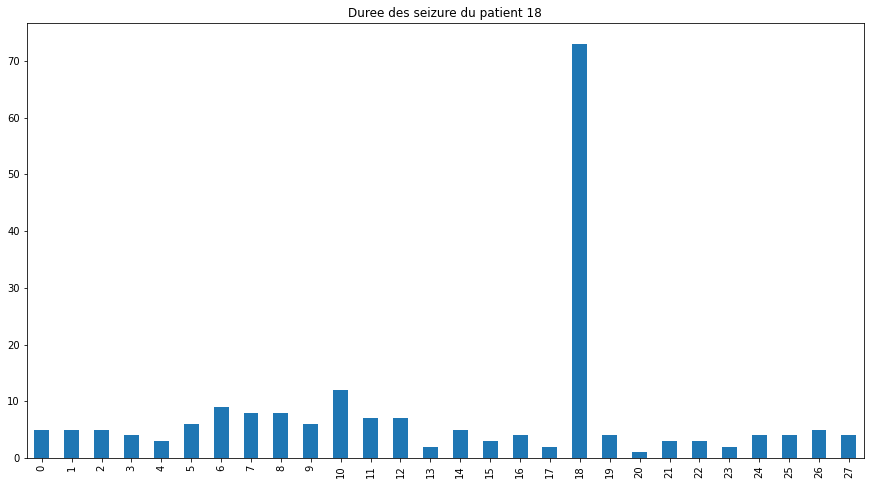

In [33]:
plt.figure(figsize=(15,8))
df_seizure.duration_sec.plot(kind="bar", title="Duree des seizure du patient 18")

<AxesSubplot:title={'center':'Duree des interseizures du patient 18'}>

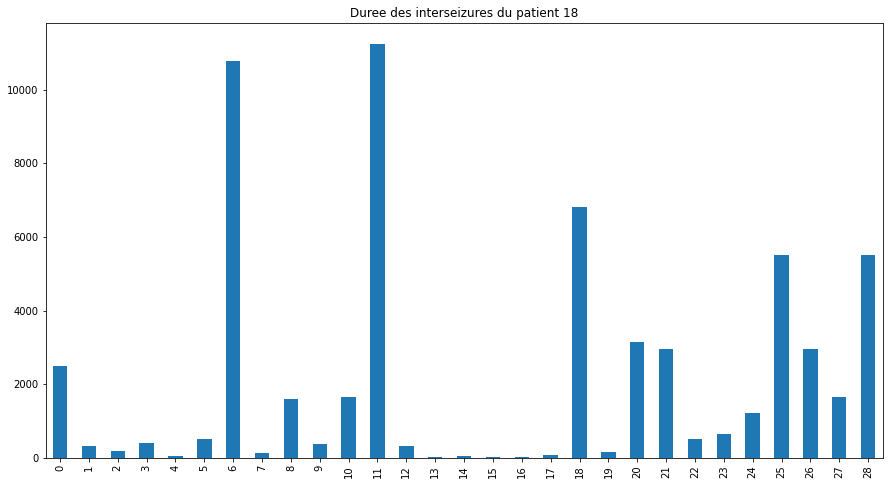

In [34]:
plt.figure(figsize=(15,8))
df_interseizure.duration_sec.plot(kind="bar", title="Duree des interseizures du patient 18")

In [35]:
result = {}
for index, row in df_seizure.iterrows():
    result[index]=df_session_copy.loc[row['start_date']:row['end_date']]

In [36]:
inter_result = {}
for index, row in df_interseizure.iterrows():
    inter_result[index]=df_session_copy.loc[row['start_date']:row['end_date']]

Max corr from seizure and non seizure

<AxesSubplot:xlabel='label', ylabel='mean_nni'>

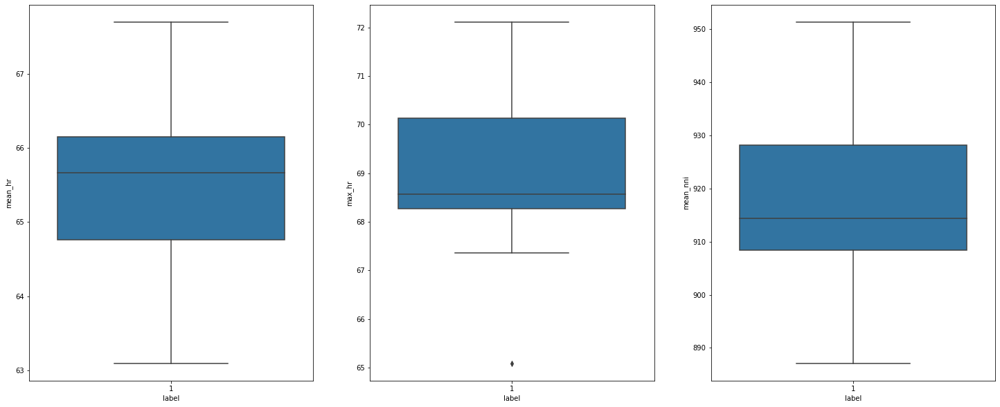

In [37]:
plt.figure(figsize=(25,10))
plt.subplot(1,3,1)
sns.boxplot(x='label',y='mean_hr', data=result[18])
plt.subplot(1,3,2)
sns.boxplot(x='label',y='max_hr', data=result[18])
plt.subplot(1,3,3)
sns.boxplot(x='label',y='mean_nni', data=result[18])

<AxesSubplot:xlabel='label', ylabel='mean_nni'>

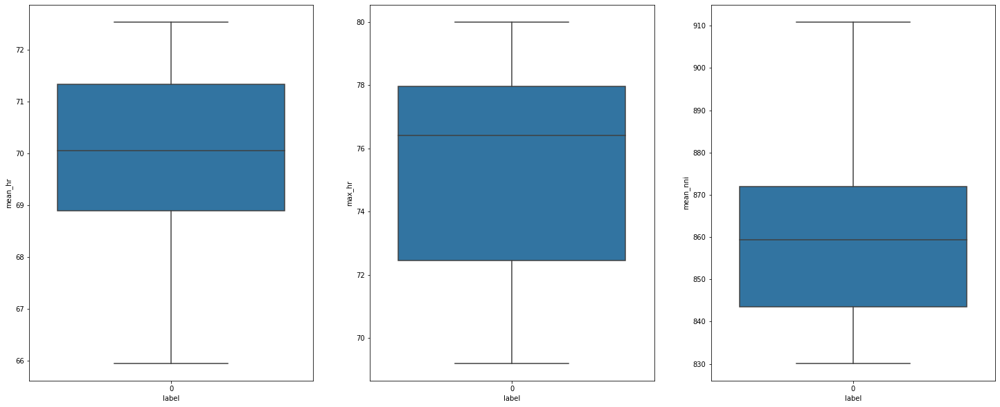

In [38]:
plt.figure(figsize=(25,10))
plt.subplot(1,3,1)
sns.boxplot(x='label',y='mean_hr', data=inter_result[4])
plt.subplot(1,3,2)
sns.boxplot(x='label',y='max_hr', data=inter_result[4])
plt.subplot(1,3,3)
sns.boxplot(x='label',y='mean_nni', data=inter_result[4])

Min corr from seizure and non seizure

<AxesSubplot:xlabel='label', ylabel='lf_hf_ratio'>

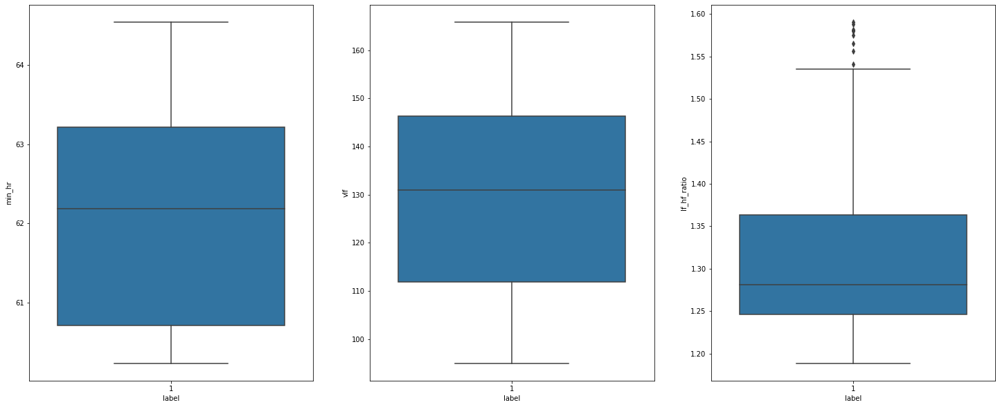

In [39]:
plt.figure(figsize=(25,10))
plt.subplot(1,3,1)
sns.boxplot(x='label',y='min_hr', data=result[18])
plt.subplot(1,3,2)
sns.boxplot(x='label',y='vlf', data=result[18])
plt.subplot(1,3,3)
sns.boxplot(x='label',y='lf_hf_ratio', data=result[18])

<AxesSubplot:xlabel='label', ylabel='lf_hf_ratio'>

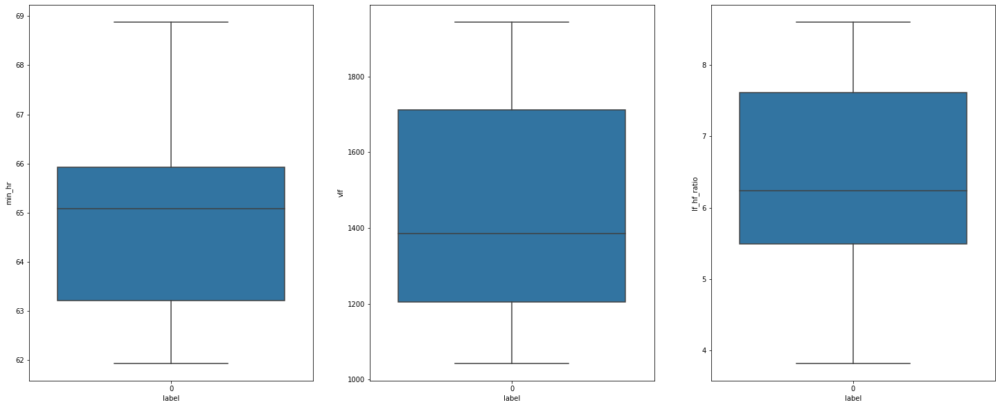

In [40]:
plt.figure(figsize=(25,10))
plt.subplot(1,3,1)
sns.boxplot(x='label',y='min_hr', data=inter_result[4])
plt.subplot(1,3,2)
sns.boxplot(x='label',y='vlf', data=inter_result[4])
plt.subplot(1,3,3)
sns.boxplot(x='label',y='lf_hf_ratio', data=inter_result[4])

Max corr dist from seizure and non seizure

<AxesSubplot:xlabel='mean_nni', ylabel='Density'>

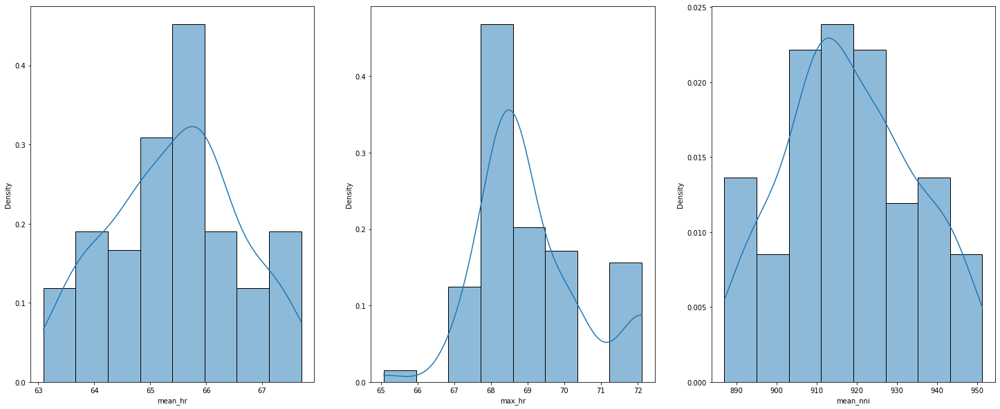

In [41]:
plt.figure(figsize=(25,10))
plt.subplot(1,3,1)
sns.histplot(data=result[18]['mean_hr'], kde=True, stat='density')
plt.subplot(1,3,2)
sns.histplot(data=result[18]['max_hr'], kde=True, stat='density')
plt.subplot(1,3,3)
sns.histplot(data=result[18]['mean_nni'], kde=True, stat='density')

<AxesSubplot:xlabel='mean_nni', ylabel='Density'>

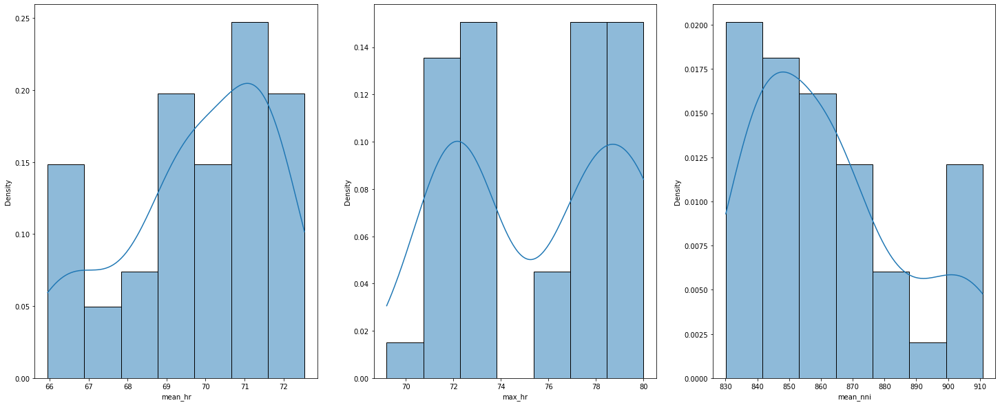

In [42]:
plt.figure(figsize=(25,10))
plt.subplot(1,3,1)
sns.histplot(data=inter_result[4]['mean_hr'], kde=True, stat='density')
plt.subplot(1,3,2)
sns.histplot(data=inter_result[4]['max_hr'], kde=True, stat='density')
plt.subplot(1,3,3)
sns.histplot(data=inter_result[4]['mean_nni'], kde=True, stat='density')

Min corr dist from seizure and non seizure

<AxesSubplot:xlabel='lf_hf_ratio', ylabel='Density'>

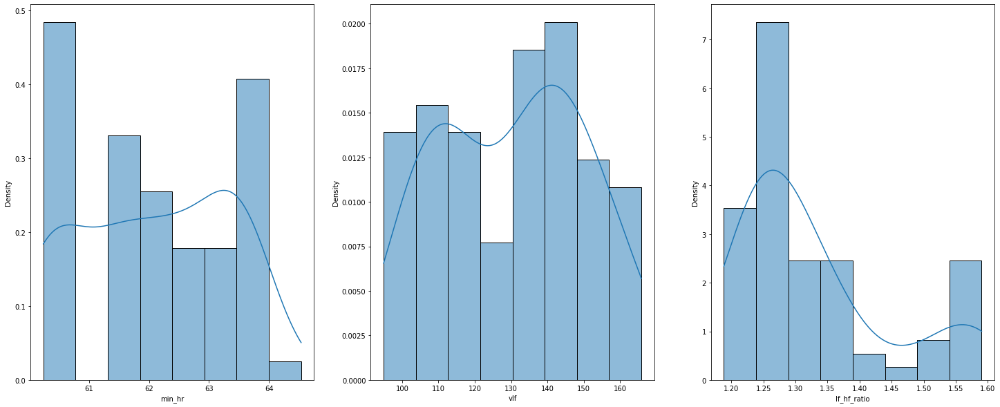

In [43]:
plt.figure(figsize=(25,10))
plt.subplot(1,3,1)
sns.histplot(data=result[18]['min_hr'], kde=True, stat='density')
plt.subplot(1,3,2)
sns.histplot(data=result[18]['vlf'], kde=True, stat='density')
plt.subplot(1,3,3)
sns.histplot(data=result[18]['lf_hf_ratio'], kde=True, stat='density')

<AxesSubplot:xlabel='lf_hf_ratio', ylabel='Density'>

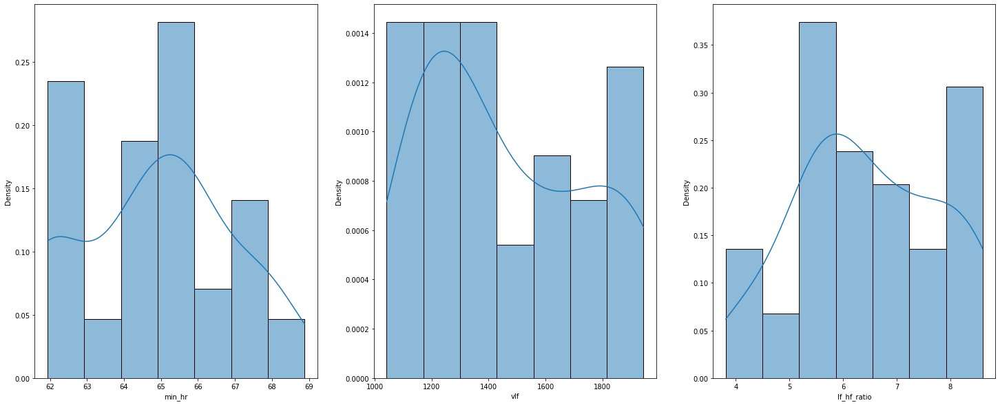

In [44]:
plt.figure(figsize=(25,10))
plt.subplot(1,3,1)
sns.histplot(data=inter_result[4]['min_hr'], kde=True, stat='density')
plt.subplot(1,3,2)
sns.histplot(data=inter_result[4]['vlf'], kde=True, stat='density')
plt.subplot(1,3,3)
sns.histplot(data=inter_result[4]['lf_hf_ratio'], kde=True, stat='density')

In [45]:
#Duree totale des interseizure
df_interseizure['duration_sec'].sum()

61461.0

In [46]:
#Duree moyenne des interseizures
df_interseizure['duration_sec'].mean()

2119.344827586207

In [47]:
#Ecart type des interseizures
df_interseizure['duration_sec'].std()

3071.3377992085616

##### Patient 50

In [15]:
df_session_50 = pd.read_csv(df_files.loc[106]["path"])
df_session_50.head()

,interval_index,interval_start_time,mean_nni,sdnn,sdsd,nni_50,pnni_50,nni_20,pnni_20,rmssd,...,csi,cvi,Modified_csi,sampen,sd1,sd2,ratio_sd2_sd1,timestamp,filename,label
0,1.0,1000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2017-07-10 15:42:19.230468750,/home/aura-sakhite/seizure_detection_pipeline/...,0
1,2.0,2000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2017-07-10 15:42:20.230468750,/home/aura-sakhite/seizure_detection_pipeline/...,0
2,3.0,3000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2017-07-10 15:42:21.230468750,/home/aura-sakhite/seizure_detection_pipeline/...,0
3,4.0,4000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2017-07-10 15:42:22.230468750,/home/aura-sakhite/seizure_detection_pipeline/...,0
4,5.0,5000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2017-07-10 15:42:23.230468750,/home/aura-sakhite/seizure_detection_pipeline/...,0


In [36]:
df_session_50.label.unique()

array([0, 1])

In [37]:
df_session_50.describe()

,interval_index,interval_start_time,mean_nni,sdnn,sdsd,nni_50,pnni_50,nni_20,pnni_20,rmssd,...,vlf,lf_hf_ratio,csi,cvi,Modified_csi,sampen,sd1,sd2,ratio_sd2_sd1,label
count,61078.000000,6.107800e+04,60776.000000,60776.000000,60776.000000,61069.000000,61069.000000,61069.000000,61069.000000,60776.000000,...,60640.000000,60640.000000,60727.000000,60727.000000,60727.000000,6.101900e+04,60727.000000,60727.000000,60727.000000,61078.000000
mean,30539.500000,3.053950e+07,927.330121,64.043229,61.917648,4.155496,42.389287,7.195205,72.044765,63.020875,...,2871.494017,3.263053,2.268911,4.823283,1168.894922,inf,47.309334,108.096596,2.268911,0.006680
std,17631.844208,1.763184e+07,149.090605,42.425782,30.468139,2.311858,22.332543,2.043574,17.359292,30.985106,...,4505.090040,2.091062,0.959590,0.339580,1236.127248,NaN,16.869258,65.885776,0.959590,0.081458
min,1.000000,1.000000e+03,415.364583,6.229039,5.752100,0.000000,0.000000,0.000000,0.000000,5.812686,...,26.588179,0.326433,0.644136,4.015404,82.785747,1.517669e-01,14.912976,29.511312,0.644136,0.000000
25%,15270.250000,1.527025e+07,804.361979,38.623240,41.316763,3.000000,25.000000,6.000000,61.538462,42.125968,...,558.738949,1.759440,1.553312,4.567240,406.848759,1.304949e+00,34.789070,62.602543,1.553312,0.000000
50%,30539.500000,3.053950e+07,966.015625,51.230816,56.504394,4.000000,44.444444,7.000000,75.000000,57.599713,...,1162.642272,2.687290,2.099436,4.775817,701.573668,1.714798e+00,45.890482,85.322080,2.099436,0.000000
75%,45808.750000,4.580875e+07,1051.171875,73.552459,75.036612,5.000000,60.000000,8.000000,87.500000,76.369158,...,2988.232671,4.253152,2.774874,5.036243,1432.077486,2.219203e+00,56.106971,131.393699,2.774874,0.000000
max,61078.000000,6.107800e+07,1497.070312,608.046428,467.133606,20.000000,100.000000,22.000000,100.000000,501.928425,...,51095.572658,18.132977,7.575668,6.162108,10314.732182,inf,197.239947,485.731824,7.575668,1.000000


In [38]:
df_session_50.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 61078 entries, 0 to 61077
Data columns (total 32 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   interval_index       61078 non-null  float64
 1   interval_start_time  61078 non-null  float64
 2   mean_nni             60776 non-null  float64
 3   sdnn                 60776 non-null  float64
 4   sdsd                 60776 non-null  float64
 5   nni_50               61069 non-null  float64
 6   pnni_50              61069 non-null  float64
 7   nni_20               61069 non-null  float64
 8   pnni_20              61069 non-null  float64
 9   rmssd                60776 non-null  float64
 10  median_nni           60776 non-null  float64
 11  range_nni            60776 non-null  float64
 12  cvsd                 60776 non-null  float64
 13  cvnni                60776 non-null  float64
 14  mean_hr              60776 non-null  float64
 15  max_hr               60776 non-null 

##### Corrélation dans le temps pour le patient 50

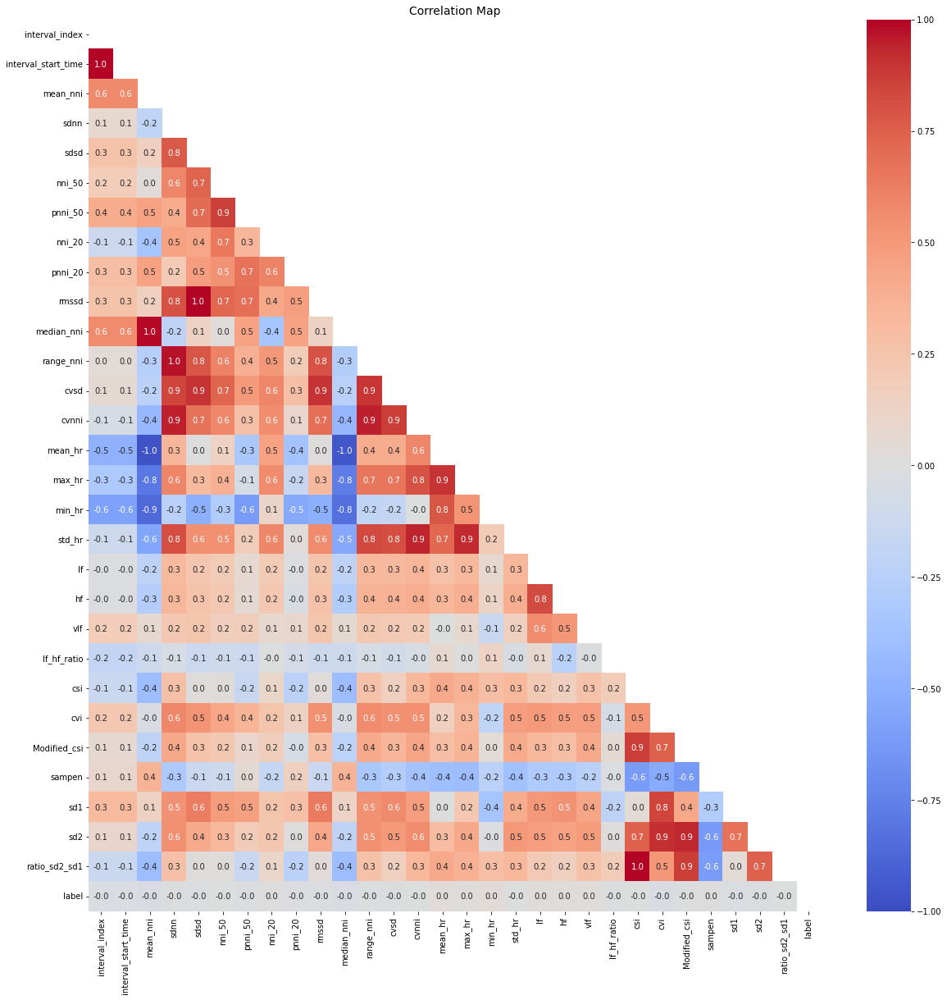

In [16]:
f, ax = plt.subplots(figsize = (20,20))
corr = df_session_50.corr()
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask)] = True
sns.heatmap(df_session_50.corr(), mask=mask, annot=True, fmt='.1f',
            ax=ax, cmap='coolwarm', vmin=-1, vmax=1)
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.title('Correlation Map', size=14);

In [39]:
df_session_50.corr()['label']

interval_index        -0.029769
interval_start_time   -0.029769
mean_nni              -0.036243
sdnn                  -0.010492
sdsd                  -0.021180
nni_50                -0.005429
pnni_50               -0.017155
nni_20                 0.006724
pnni_20               -0.019510
rmssd                 -0.021383
median_nni            -0.036449
range_nni             -0.010174
cvsd                  -0.011342
cvnni                 -0.005051
mean_hr                0.025699
max_hr                 0.009365
min_hr                 0.036694
std_hr                -0.003965
lf                     0.020464
hf                     0.023157
vlf                    0.016736
lf_hf_ratio           -0.009219
csi                   -0.002308
cvi                   -0.031622
Modified_csi          -0.011716
sampen                 0.005531
sd1                   -0.028413
sd2                   -0.015648
ratio_sd2_sd1         -0.002308
label                  1.000000
Name: label, dtype: float64

In [53]:
df_session_50.corr()

,interval_index,interval_start_time,mean_nni,sdnn,sdsd,nni_50,pnni_50,nni_20,pnni_20,rmssd,...,vlf,lf_hf_ratio,csi,cvi,Modified_csi,sampen,sd1,sd2,ratio_sd2_sd1,label
interval_index,1.000000,1.000000,0.575228,0.078123,0.261641,0.185340,0.398534,-0.130515,0.296062,0.264563,...,0.187317,-0.174606,-0.138128,0.232100,0.062566,0.087358,0.315714,0.096875,-0.138128,-0.029769
interval_start_time,1.000000,1.000000,0.575228,0.078123,0.261641,0.185340,0.398534,-0.130515,0.296062,0.264563,...,0.187317,-0.174606,-0.138128,0.232100,0.062566,0.087358,0.315714,0.096875,-0.138128,-0.029769
mean_nni,0.575228,0.575228,1.000000,-0.200740,0.160971,0.023824,0.459928,-0.355130,0.456788,0.158384,...,0.066392,-0.123877,-0.409293,-0.033278,-0.218377,0.363050,0.144410,-0.206887,-0.409293,-0.036243
sdnn,0.078123,0.078123,-0.200740,1.000000,0.770051,0.591053,0.405083,0.453266,0.210757,0.797693,...,0.231439,-0.050796,0.279836,0.579002,0.427525,-0.310234,0.537898,0.551519,0.279836,-0.010492
sdsd,0.261641,0.261641,0.160971,0.770051,1.000000,0.731690,0.699165,0.432136,0.478927,0.996912,...,0.244058,-0.126515,0.010394,0.528275,0.265023,-0.134498,0.629751,0.413560,0.010394,-0.021180
nni_50,0.185340,0.185340,0.023824,0.591053,0.731690,1.000000,0.860188,0.650572,0.536188,0.726523,...,0.169869,-0.101644,0.019424,0.434658,0.221996,-0.124799,0.486376,0.329425,0.019424,-0.005429
pnni_50,0.398534,0.398534,0.459928,0.405083,0.699165,0.860188,1.000000,0.348402,0.676431,0.694786,...,0.172816,-0.130956,-0.151284,0.352445,0.097149,0.047713,0.466781,0.187734,-0.151284,-0.017155
nni_20,-0.130515,-0.130515,-0.355130,0.453266,0.432136,0.650572,0.348402,1.000000,0.605700,0.425858,...,0.073864,-0.003320,0.102446,0.246888,0.166170,-0.164467,0.242213,0.239202,0.102446,0.006724
pnni_20,0.296062,0.296062,0.456788,0.210757,0.478927,0.536188,0.676431,0.605700,1.000000,0.472962,...,0.093173,-0.070184,-0.232832,0.147806,-0.048878,0.152896,0.274637,0.014130,-0.232832,-0.019510
rmssd,0.264563,0.264563,0.158384,0.797693,0.996912,0.726523,0.694786,0.425858,0.472962,1.000000,...,0.249140,-0.124541,0.027128,0.541918,0.282126,-0.144966,0.636373,0.430275,0.027128,-0.021383


In [54]:
sort_corr = np.abs(df_session_50.corr()).sort_values(by='label', ascending=False)
sort_corr

,interval_index,interval_start_time,mean_nni,sdnn,sdsd,nni_50,pnni_50,nni_20,pnni_20,rmssd,...,vlf,lf_hf_ratio,csi,cvi,Modified_csi,sampen,sd1,sd2,ratio_sd2_sd1,label
label,0.029769,0.029769,0.036243,0.010492,0.021180,0.005429,0.017155,0.006724,0.019510,0.021383,...,0.016736,0.009219,0.002308,0.031622,0.011716,0.005531,0.028413,0.015648,0.002308,1.000000
min_hr,0.581950,0.581950,0.865336,0.239903,0.499014,0.295970,0.609582,0.116253,0.537279,0.506339,...,0.149459,0.130985,0.291480,0.198678,0.045272,0.231909,0.358517,0.021216,0.291480,0.036694
median_nni,0.564303,0.564303,0.990975,0.211772,0.147342,0.023791,0.457807,0.350054,0.456864,0.144132,...,0.060034,0.120996,0.407905,0.040805,0.222664,0.361345,0.132506,0.213756,0.407905,0.036449
mean_nni,0.575228,0.575228,1.000000,0.200740,0.160971,0.023824,0.459928,0.355130,0.456788,0.158384,...,0.066392,0.123877,0.409293,0.033278,0.218377,0.363050,0.144410,0.206887,0.409293,0.036243
cvi,0.232100,0.232100,0.033278,0.579002,0.528275,0.434658,0.352445,0.246888,0.147806,0.541918,...,0.483977,0.061136,0.514590,1.000000,0.748268,0.523592,0.848844,0.910999,0.514590,0.031622
interval_index,1.000000,1.000000,0.575228,0.078123,0.261641,0.185340,0.398534,0.130515,0.296062,0.264563,...,0.187317,0.174606,0.138128,0.232100,0.062566,0.087358,0.315714,0.096875,0.138128,0.029769
interval_start_time,1.000000,1.000000,0.575228,0.078123,0.261641,0.185340,0.398534,0.130515,0.296062,0.264563,...,0.187317,0.174606,0.138128,0.232100,0.062566,0.087358,0.315714,0.096875,0.138128,0.029769
sd1,0.315714,0.315714,0.144410,0.537898,0.629751,0.486376,0.466781,0.242213,0.274637,0.636373,...,0.442595,0.212224,0.046698,0.848844,0.422177,0.286629,1.000000,0.675855,0.046698,0.028413
mean_hr,0.481724,0.481724,0.962797,0.344105,0.005779,0.137057,0.322540,0.456717,0.368537,0.009142,...,0.003257,0.065368,0.415112,0.162566,0.292765,0.402820,0.006860,0.308249,0.415112,0.025699
hf,0.020896,0.020896,0.273363,0.342327,0.262160,0.221322,0.054879,0.232802,0.042944,0.265739,...,0.512376,0.248755,0.157774,0.474286,0.293422,0.301554,0.535168,0.454706,0.157774,0.023157


In [55]:
sort_corr['label'].head(4)

label         1.000000
min_hr        0.036694
median_nni    0.036449
mean_nni      0.036243
Name: label, dtype: float64

In [56]:
sort_corr['label'].loc['std_hr':]

std_hr           0.003965
csi              0.002308
ratio_sd2_sd1    0.002308
Name: label, dtype: float64

In [57]:
df_session_50.corr()['label'].unique()

array([-0.02976891, -0.02976891, -0.03624304, -0.01049196, -0.02117995,
       -0.00542922, -0.01715531,  0.00672367, -0.01950975, -0.02138293,
       -0.03644885, -0.01017408, -0.01134177, -0.00505087,  0.02569924,
        0.00936524,  0.03669355, -0.00396454,  0.02046435,  0.02315743,
        0.01673619, -0.00921935, -0.00230779, -0.03162208, -0.0117162 ,
        0.00553123, -0.02841332, -0.01564843,  1.        ])

In [58]:
#session start
df_session_50['timestamp'].iloc[0]

'2017-07-10 15:42:19.230468750'

In [59]:
#session end
df_session_50['timestamp'].iloc[-1]

'2017-07-11 08:40:16.230468750'

In [60]:
#session duration : since time between row is 1sec
df_session_50.shape[0]

61078

In [61]:
#session in hour
df_session_50.shape[0]/3600

16.96611111111111

In [62]:
#total_seizure_duration_sec
df_session_50[df_session_50['label']==1].label.sum()

408

In [63]:
#total_interseizure_duration_sec
(df_session_50['label'] == 0).sum()    

60670

In [64]:
df_session_50 = df_session_50.sort_values(by = 'timestamp').reset_index(drop=True)

In [65]:
## Analysis of seizures inside session ##
# Detect change of state
df_session_50['previous_label'] = df_session_50['label'].shift(1)
df_session_50['change_of_state'] = (df_session_50['label'] != df_session_50['previous_label'])
df_session_50['change_of_state'].value_counts()
df_session_50['future_change_of_state'] = df_session_50['change_of_state'].shift(-1).fillna(True)

<AxesSubplot:xlabel='label', ylabel='mean_nni'>

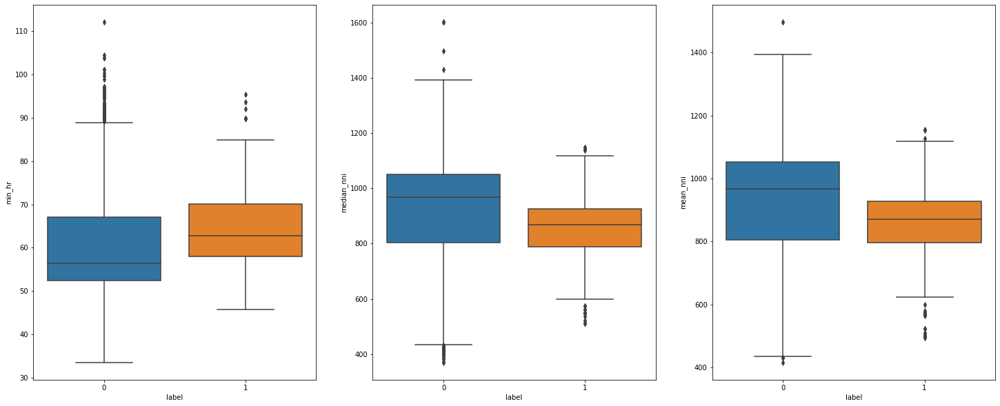

In [66]:
plt.figure(figsize=(25,10))
plt.subplot(1,3,1)
sns.boxplot(x='label',y='min_hr', data=df_session_50)
plt.subplot(1,3,2)
sns.boxplot(x='label',y='median_nni', data=df_session_50)
plt.subplot(1,3,3)
sns.boxplot(x='label',y='mean_nni', data=df_session_50)

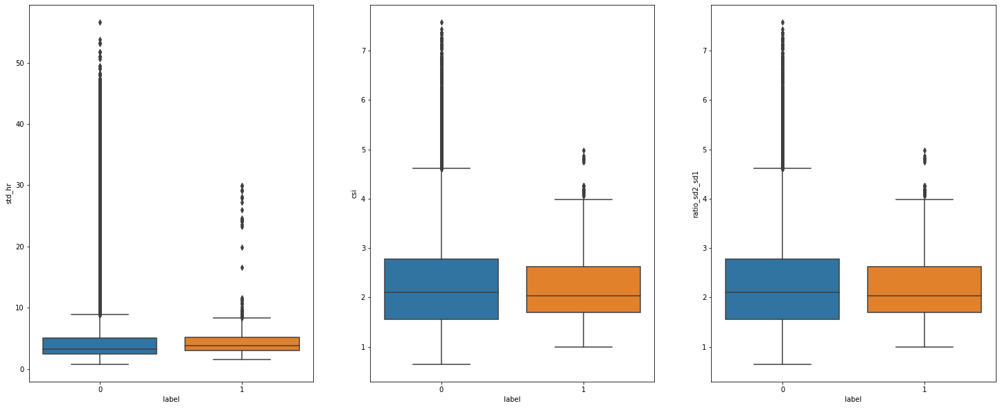

In [67]:
plt.figure(figsize=(25,10))
plt.subplot(1,3,1)
sns.boxplot(x='label',y='std_hr', data=df_session_50);
plt.subplot(1,3,2)
sns.boxplot(x='label',y='csi', data=df_session_50);
plt.subplot(1,3,3)
sns.boxplot(x='label',y='ratio_sd2_sd1', data=df_session_50);

In [34]:
df_session_50_1 = df_session_50.dropna()[df_session_50.dropna()['label']==1]
df_session_50_0 = df_session_50.dropna()[df_session_50.dropna()['label']==0]

In [36]:
t_stat, p = ttest_ind(df_session_50_1['min_hr'], df_session_50_1['min_hr'])
print(f't={t_stat}, p={p}')

t=0.0, p=1.0


In [37]:
t_stat, p = ttest_ind(df_session_50_1['ratio_sd2_sd1'], df_session_50_1['ratio_sd2_sd1'])
print(f't={t_stat}, p={p}')

t=0.0, p=1.0


#### Distribution des variables les plus corrélées aux données

<AxesSubplot:xlabel='mean_nni', ylabel='Density'>

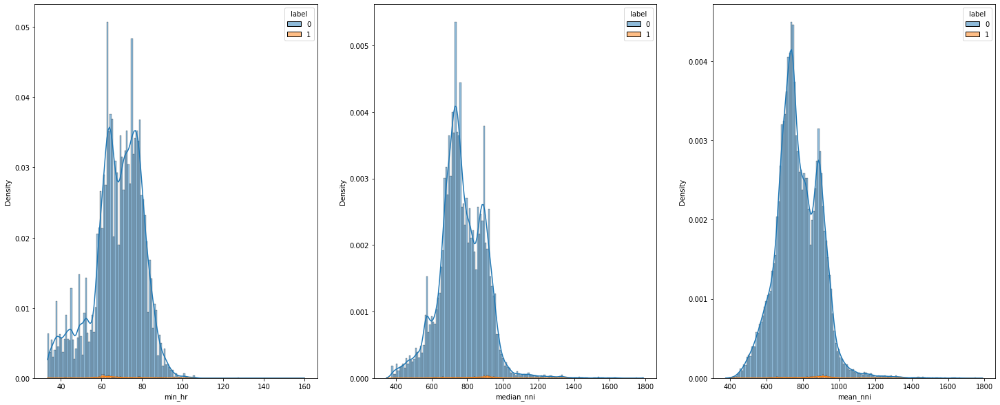

In [68]:
plt.figure(figsize=(25,10))
plt.subplot(1,3,1)
sns.histplot(data=df_session, x='min_hr', kde=True, hue="label", multiple="stack", stat='density')
plt.subplot(1,3,2)
sns.histplot(data=df_session, x='median_nni', kde=True, hue="label", multiple="stack", stat='density')
plt.subplot(1,3,3)
sns.histplot(data=df_session, x='mean_nni', kde=True, hue="label", multiple="stack", stat='density')

#### Distribution des variables les moins corrélées

<AxesSubplot:xlabel='ratio_sd2_sd1', ylabel='Density'>

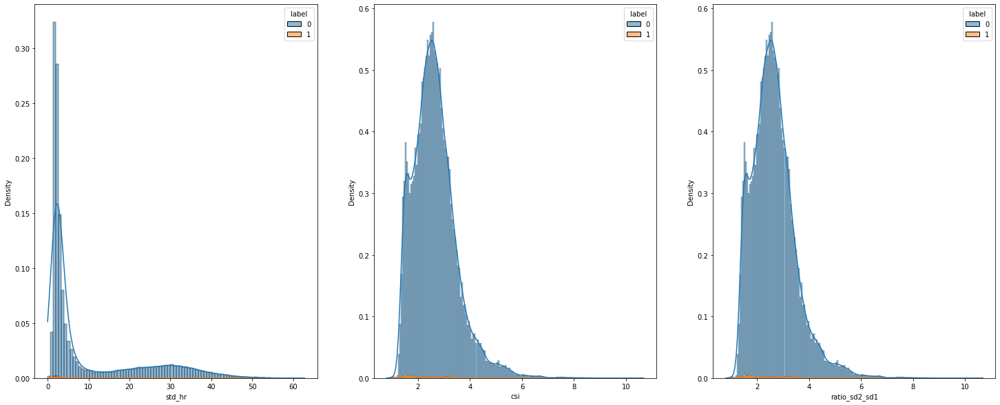

In [69]:
plt.figure(figsize=(25,10))
plt.subplot(1,3,1)
sns.histplot(data=df_session, x='std_hr', kde=True, hue="label", multiple="stack", stat='density')
plt.subplot(1,3,2)
sns.histplot(data=df_session, x='csi', kde=True, hue="label", multiple="stack", stat='density')
plt.subplot(1,3,3)
sns.histplot(data=df_session, x='ratio_sd2_sd1', kde=True, hue="label", multiple="stack", stat='density')

#### Seizure informations from session

In [70]:
df_seizure_50 = pd.DataFrame()
df_seizure_50['start_date'] = df_session_50.loc[(df_session_50['label']==1) 
                                               & (df_session_50['change_of_state']), 'timestamp'].reset_index(
        drop=True)
df_seizure_50['end_date'] = df_session_50.loc[(df_session_50['label']==1) 
                                             &(df_session_50['future_change_of_state']),'timestamp'].reset_index(
        drop=True)

df_seizure_50['duration_sec'] = (pd.to_datetime(df_seizure_50['end_date']) 
                                 - pd.to_datetime(df_seizure_50['start_date'])).apply(
        lambda x : x.total_seconds() + 1)

In [71]:
# Create df_interseizures with detail of start and end of each interseizure
df_interseizure_50 = pd.DataFrame()
df_interseizure_50['start_date'] = df_session_50.loc[(df_session_50['label']==0) 
                                           & (df_session_50['change_of_state']), 'timestamp'].reset_index(
    drop=True)
df_interseizure_50['end_date'] = df_session_50.loc[(df_session_50['label']==0) 
                                         &(df_session_50['future_change_of_state']),'timestamp'].reset_index(
    drop=True)

df_interseizure_50['duration_sec'] = (pd.to_datetime(df_interseizure_50['end_date']) 
                             - pd.to_datetime(df_interseizure_50['start_date'])).apply(lambda x: 
                                                                                     x.total_seconds()+1)

In [72]:
df_seizure_50.head()

,start_date,end_date,duration_sec
0,2017-07-10 15:54:29.230468750,2017-07-10 15:54:56.230468750,28.0
1,2017-07-10 17:23:07.230468750,2017-07-10 17:23:18.230468750,12.0
2,2017-07-10 18:23:46.230468750,2017-07-10 18:24:02.230468750,17.0
3,2017-07-10 18:32:47.230468750,2017-07-10 18:33:03.230468750,17.0
4,2017-07-10 19:11:00.230468750,2017-07-10 19:11:16.230468750,17.0


In [73]:
df_interseizure_50.head()

,start_date,end_date,duration_sec
0,2017-07-10 15:42:19.230468750,2017-07-10 15:54:28.230468750,730.0
1,2017-07-10 15:54:57.230468750,2017-07-10 17:23:06.230468750,5290.0
2,2017-07-10 17:23:19.230468750,2017-07-10 18:23:45.230468750,3627.0
3,2017-07-10 18:24:03.230468750,2017-07-10 18:32:46.230468750,524.0
4,2017-07-10 18:33:04.230468750,2017-07-10 19:10:59.230468750,2276.0


In [74]:
df_seizure_50.describe()

,duration_sec
count,27.000000
mean,15.111111
std,6.565254
min,4.000000
25%,10.000000
50%,15.000000
75%,19.000000
max,29.000000


In [75]:
df_interseizure_50.describe()

,duration_sec
count,28.000000
mean,2166.785714
std,2841.382832
min,60.000000
25%,238.250000
50%,823.500000
75%,3201.750000
max,11986.000000


<AxesSubplot:title={'center':'Duree des seizure du patient 50'}>

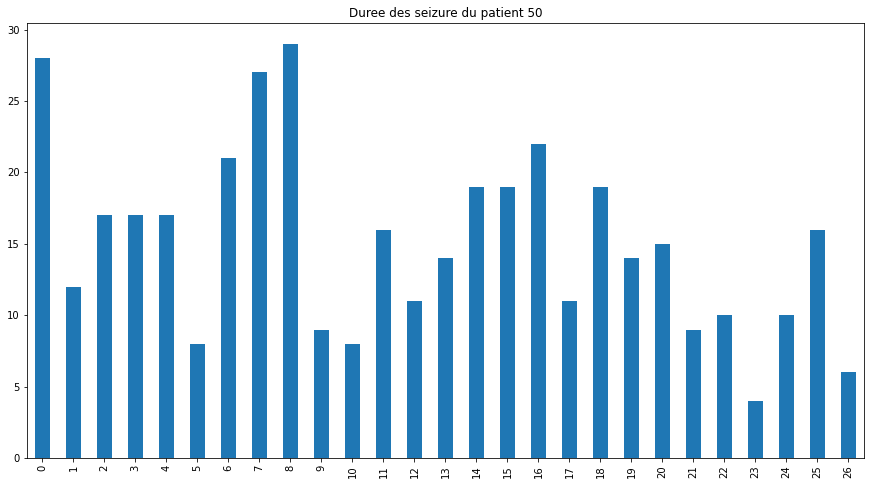

In [76]:
plt.figure(figsize=(15,8))
df_seizure_50.duration_sec.plot(kind="bar", title="Duree des seizure du patient 50")

<AxesSubplot:title={'center':'Duree des inter-seizures du patient 50'}>

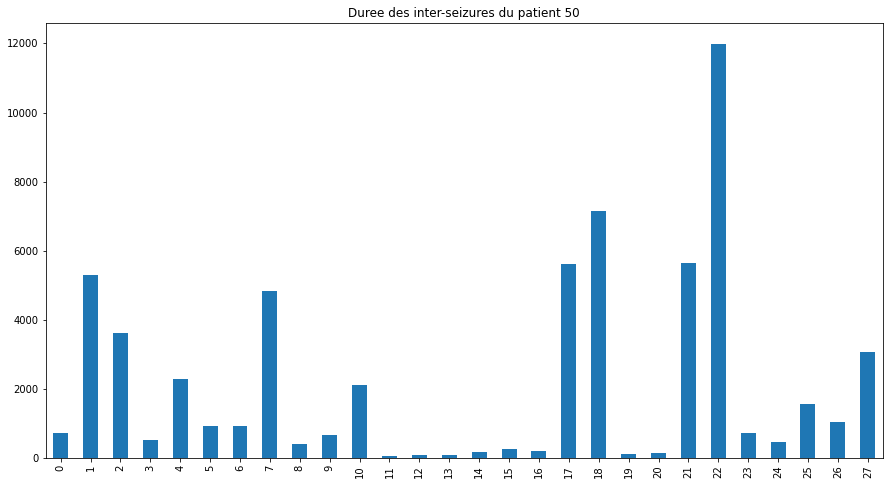

In [77]:
plt.figure(figsize=(15,8))
df_interseizure_50.duration_sec.plot(kind="bar", title="Duree des inter-seizures du patient 50")

In [78]:
df_session_50_copy = df_session_50.copy()
df_session_50_copy = df_session_50_copy.set_index("timestamp")

In [79]:
df_seizure_period = {}
for index, row in df_seizure_50.iterrows():
    df_seizure_period[index]=df_session_50_copy.loc[row['start_date']:row['end_date']]

In [80]:
df_interseizure_period = {}
for index, row in df_interseizure_50.iterrows():
    df_interseizure_period[index]=df_session_50_copy.loc[row['start_date']:row['end_date']]

Max corr from seizure and non seizure

<AxesSubplot:xlabel='label', ylabel='mean_nni'>

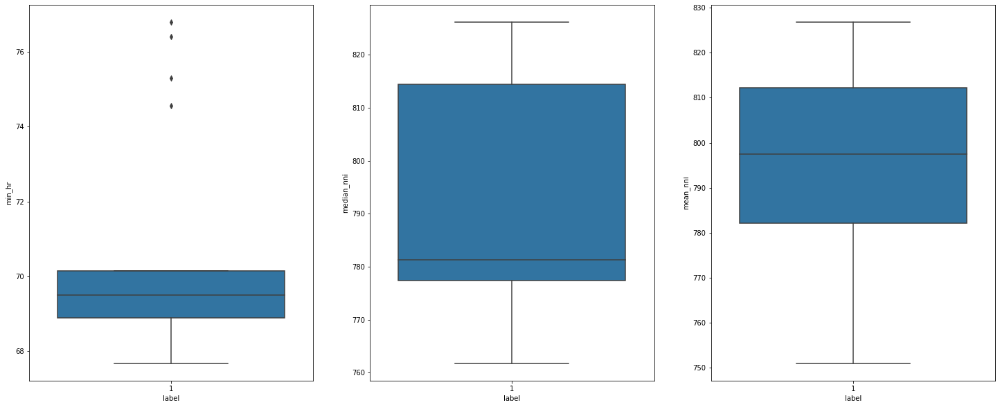

In [81]:
plt.figure(figsize=(25,10))
plt.subplot(1,3,1)
sns.boxplot(x='label',y='min_hr', data=df_seizure_period[8])
plt.subplot(1,3,2)
sns.boxplot(x='label',y='median_nni', data=df_seizure_period[8])
plt.subplot(1,3,3)
sns.boxplot(x='label',y='mean_nni', data=df_seizure_period[8])

<AxesSubplot:xlabel='label', ylabel='mean_nni'>

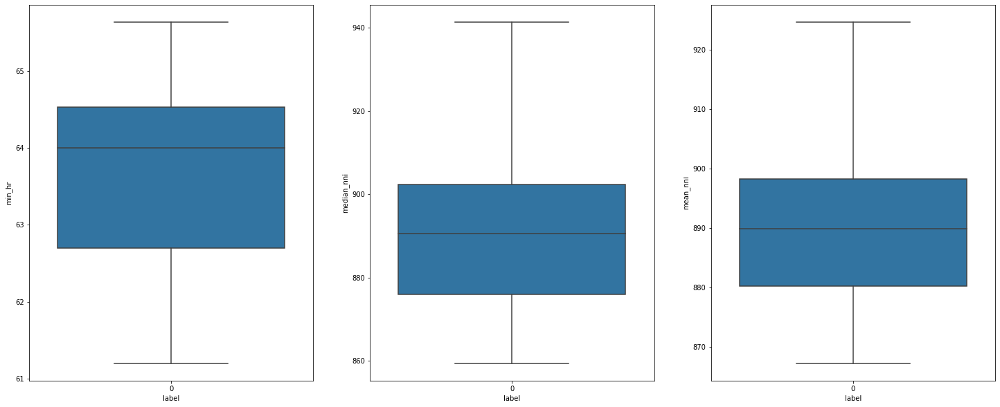

In [82]:
plt.figure(figsize=(25,10))
plt.subplot(1,3,1)
sns.boxplot(x='label',y='min_hr', data=df_interseizure_period[12])
plt.subplot(1,3,2)
sns.boxplot(x='label',y='median_nni', data=df_interseizure_period[12])
plt.subplot(1,3,3)
sns.boxplot(x='label',y='mean_nni', data=df_interseizure_period[12])

Min corr from seizure and non seizure

<AxesSubplot:xlabel='label', ylabel='ratio_sd2_sd1'>

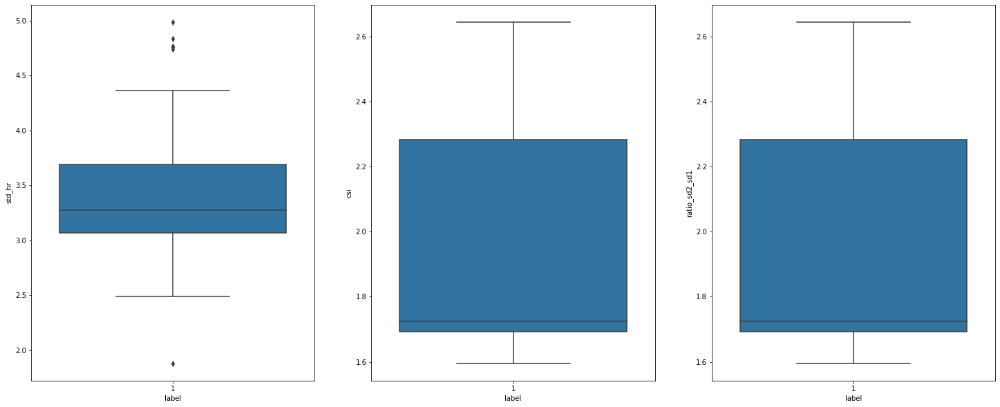

In [83]:
plt.figure(figsize=(25,10))
plt.subplot(1,3,1)
sns.boxplot(x='label',y='std_hr', data=df_seizure_period[8])
plt.subplot(1,3,2)
sns.boxplot(x='label',y='csi', data=df_seizure_period[8])
plt.subplot(1,3,3)
sns.boxplot(x='label',y='ratio_sd2_sd1', data=df_seizure_period[8])

<AxesSubplot:xlabel='label', ylabel='ratio_sd2_sd1'>

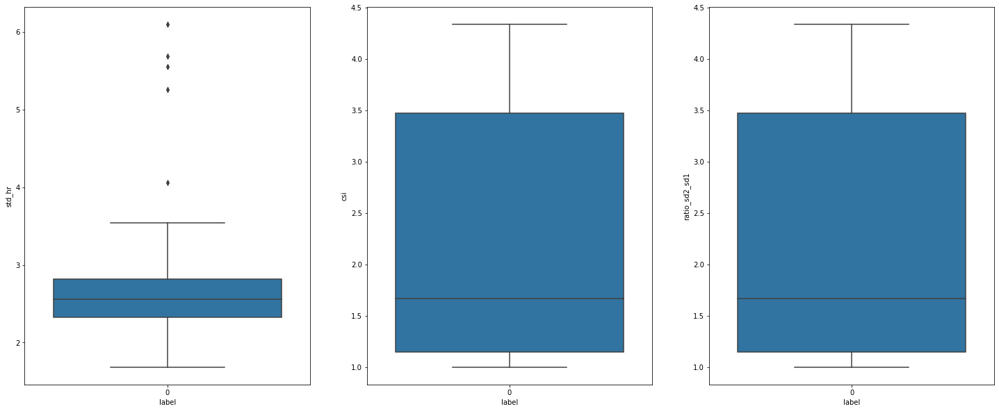

In [84]:
plt.figure(figsize=(25,10))
plt.subplot(1,3,1)
sns.boxplot(x='label',y='std_hr', data=df_interseizure_period[12])
plt.subplot(1,3,2)
sns.boxplot(x='label',y='csi', data=df_interseizure_period[12])
plt.subplot(1,3,3)
sns.boxplot(x='label',y='ratio_sd2_sd1', data=df_interseizure_period[12])

Max corr dist from seizure and non seizure

<AxesSubplot:xlabel='mean_nni', ylabel='Density'>

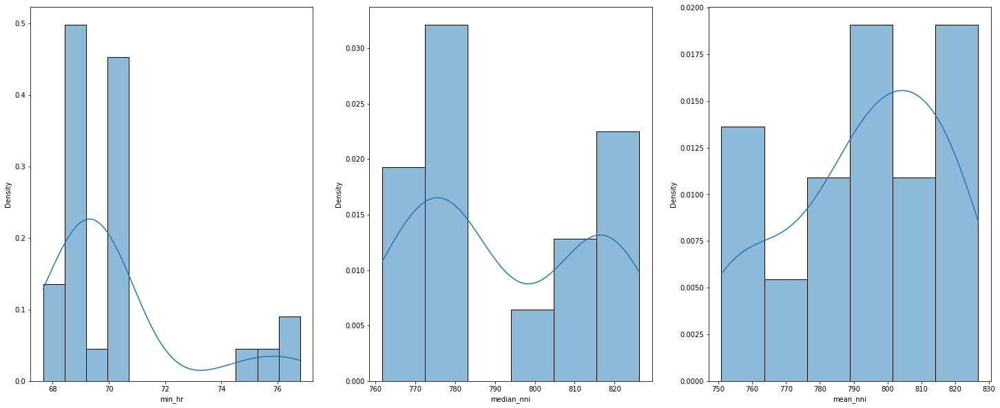

In [85]:
plt.figure(figsize=(25,10))
plt.subplot(1,3,1)
sns.histplot(data=df_seizure_period[8]['min_hr'], kde=True, stat='density')
plt.subplot(1,3,2)
sns.histplot(data=df_seizure_period[8]['median_nni'], kde=True, stat='density')
plt.subplot(1,3,3)
sns.histplot(data=df_seizure_period[8]['mean_nni'], kde=True, stat='density')

<AxesSubplot:xlabel='mean_nni', ylabel='Density'>

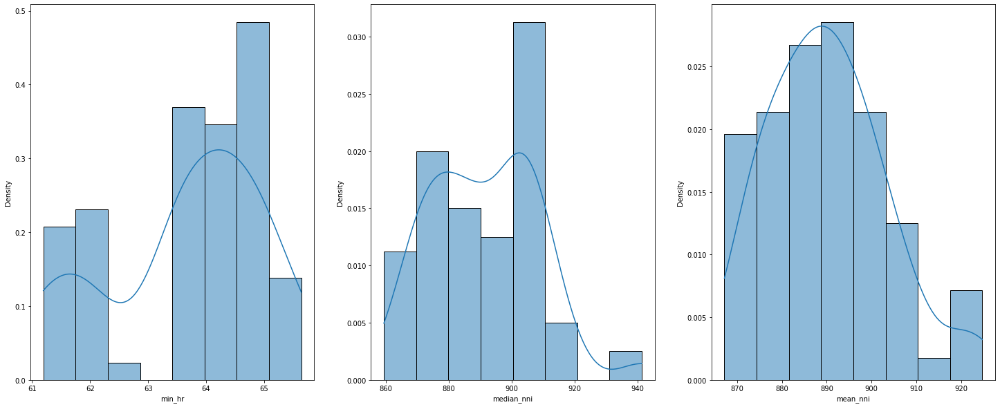

In [86]:
plt.figure(figsize=(25,10))
plt.subplot(1,3,1)
sns.histplot(data=df_interseizure_period[12]['min_hr'], kde=True, stat='density')
plt.subplot(1,3,2)
sns.histplot(data=df_interseizure_period[12]['median_nni'], kde=True, stat='density')
plt.subplot(1,3,3)
sns.histplot(data=df_interseizure_period[12]['mean_nni'], kde=True, stat='density')

Min corr dist from seizure and non seizure

<AxesSubplot:xlabel='ratio_sd2_sd1', ylabel='Density'>

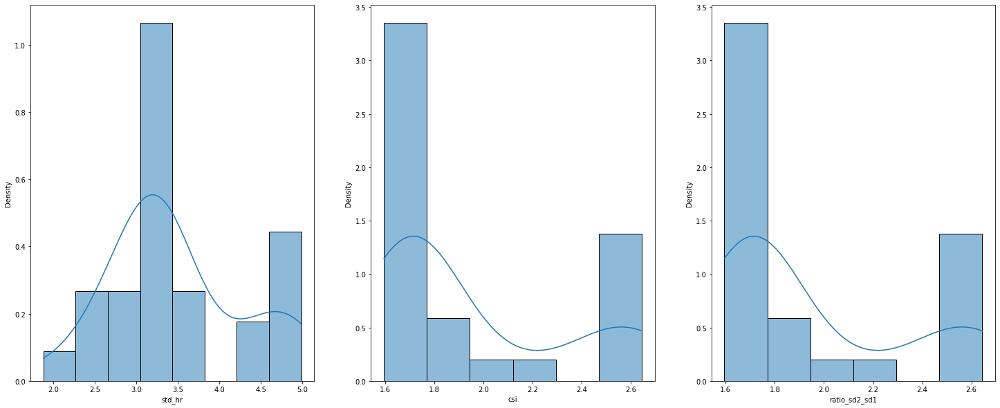

In [87]:
plt.figure(figsize=(25,10))
plt.subplot(1,3,1)
sns.histplot(data=df_seizure_period[8]['std_hr'], kde=True, stat='density')
plt.subplot(1,3,2)
sns.histplot(data=df_seizure_period[8]['csi'], kde=True, stat='density')
plt.subplot(1,3,3)
sns.histplot(data=df_seizure_period[8]['ratio_sd2_sd1'], kde=True, stat='density')

##### Corrélation entre patients

In [88]:
cols = ['mean_nni', 'sdnn', 'sdsd',
       'nni_50', 'pnni_50', 'nni_20', 'pnni_20', 'rmssd', 'median_nni',
       'range_nni', 'cvsd', 'cvnni', 'mean_hr', 'max_hr', 'min_hr', 'std_hr',
       'lf', 'hf', 'vlf', 'lf_hf_ratio', 'csi', 'cvi', 'Modified_csi',
       'sampen', 'sd1', 'sd2', 'ratio_sd2_sd1', 'label']

In [89]:
df_session.corrwith(df_session_50)

interval_index            1.000000
interval_start_time       1.000000
mean_nni                  0.275422
sdnn                      0.052250
sdsd                      0.122933
nni_50                    0.077258
pnni_50                   0.188137
nni_20                   -0.068470
pnni_20                   0.196323
rmssd                     0.123792
median_nni                0.237267
range_nni                 0.033342
cvsd                      0.037240
cvnni                     0.002438
mean_hr                   0.139646
max_hr                    0.000824
min_hr                    0.400537
std_hr                   -0.019337
lf                        0.038228
hf                        0.015028
vlf                       0.076722
lf_hf_ratio               0.034520
csi                       0.017113
cvi                       0.135768
Modified_csi              0.011876
sampen                         NaN
sd1                       0.164110
sd2                       0.060008
ratio_sd2_sd1       

Les features des deux dataframes ont une corrélation assez faible. La variable paire la plus corrélées est min_hr avec 0.400537

In [ ]:
sns.relplot(data=df_session, x="mean_hr", y="timestamp", hue="label")

### Visualisation

In [ ]:
labels_list = []
for i, p in df_files.loc[:, 'path'].iteritems():
    ## Create figure with heart rates and seizures for each session  
    if i==0:
        buttons_list = [[True]]
        labels_list = [df_files.loc[i, 'path'].split('/')[-1]]
        fig = go.Figure(
            data = go.Scatter(
                name = 'Seizure',
                x = df_session['timestamp'], 
                y = df_session['mean_hr'], 
                mode = 'markers',
                marker = go.scatter.Marker(color = df_session['label'].map({0:'blue', 1:'red'}))
            ),
            layout = go.Layout(
                title = go.layout.Title(text = "Mean heart rate and seizures vs. time", x = 0.5),
                xaxis = go.layout.XAxis(title = 'Time', 
                                        rangeslider = go.layout.xaxis.Rangeslider(visible = True)),
                yaxis = go.layout.YAxis(title = 'Mean heart rate')
            )
        )
    else:
        fig.add_trace(
            go.Scatter(
                name = 'Seizure',
                x = df_session['timestamp'], 
                y = df_session['mean_hr'], 
                mode = 'markers',
                marker = go.scatter.Marker(color = df_session['label'].map({0:'blue', 1:'red'})),
                visible = False
            )
        )
        new_list = []
        for j in range(len(buttons_list)):
            buttons_list[j].extend([False])
            new_list.extend([False])
        new_list.extend([True])
        buttons_list.append(new_list)
        
        labels_list.append(df_files.loc[i, 'path'].split('/')[-1])

In [97]:
update_buttons = [go.layout.updatemenu.Button(
                        label = labels_list[i],
                        method = "update",
                        args = [{"visible" : buttons_list[i]}]) for i in range(len(buttons_list))]

fig.update_layout(
    updatemenus = [go.layout.Updatemenu(
        active = 0,
        buttons = update_buttons,
        xanchor = 'center',
        yanchor = 'top'
    )]
)
fig.show()
pio.write_html(fig, figures_path + "heatrates_seizures_vs_time.html")

In [52]:
buttons_list = [[True]]
fig1 = go.Figure(
    data = go.Scatter(
        name = 'Seizure',
        x = df_session['timestamp'], 
        y = df_session['csi'], 
        mode = 'markers',
        marker = go.scatter.Marker(color = df_session['label'].map({0:'blue', 1:'red'}))
    ),
    layout = go.Layout(
        title = go.layout.Title(text = "Cardiac Sympathetic Index vs. time", x = 0.5),
        xaxis = go.layout.XAxis(title = 'Time', 
                                rangeslider = go.layout.xaxis.Rangeslider(visible = True)),
        yaxis = go.layout.YAxis(title = 'CSI')
    )
)

In [54]:
update_buttons = [go.layout.updatemenu.Button(
                        label = labels_list[i],
                        method = "update",
                        args = [{"visible" : buttons_list[i]}]) for i in range(len(buttons_list))]

fig1.update_layout(
    updatemenus = [go.layout.Updatemenu(
        active = 0,
        buttons = update_buttons,
        xanchor = 'center',
        yanchor = 'top'
    )]
)
fig1.show()
pio.write_html(fig, figures_path + "csi_vs_time.html")

In [42]:
df_session_seizure = df_session[df_session['label']==1]
df_session_nonseizure = df_session[df_session['label']==0]

In [43]:
df_session_seizure['label'].unique()

array([1])

In [44]:
df_session_nonseizure['label'].unique()

array([0])

<string>:6: RuntimeWarning:

Converting input from bool to <class 'numpy.uint8'> for compatibility.

<string>:6: RuntimeWarning:

Converting input from bool to <class 'numpy.uint8'> for compatibility.

<string>:6: RuntimeWarning:

Converting input from bool to <class 'numpy.uint8'> for compatibility.

<string>:6: RuntimeWarning:

Converting input from bool to <class 'numpy.uint8'> for compatibility.



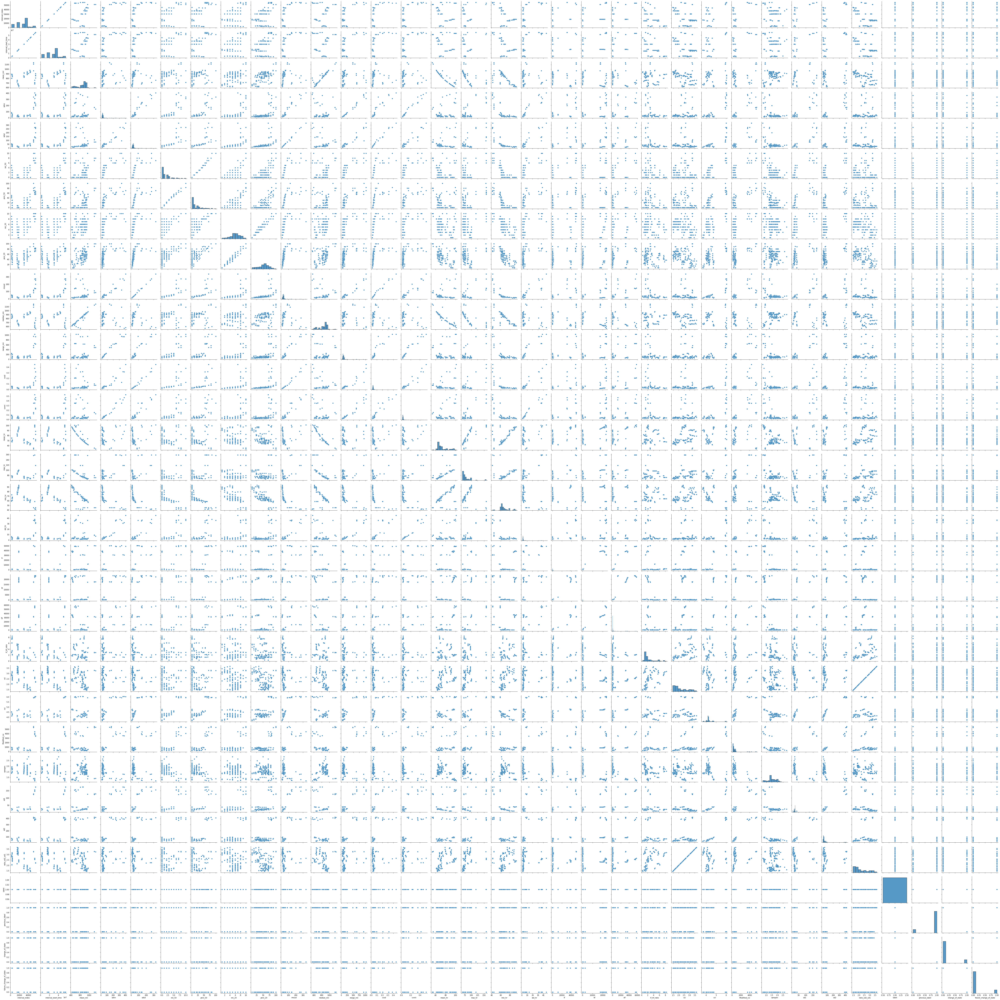

In [45]:
sns.pairplot(df_session_seizure)

In [ ]:
sns.pairplot(df_session_nonseizure)

<string>:6: RuntimeWarning:

Converting input from bool to <class 'numpy.uint8'> for compatibility.

<string>:6: RuntimeWarning:

Converting input from bool to <class 'numpy.uint8'> for compatibility.

<string>:6: RuntimeWarning:

Converting input from bool to <class 'numpy.uint8'> for compatibility.

<string>:6: RuntimeWarning:

Converting input from bool to <class 'numpy.uint8'> for compatibility.

